In [2]:
import os.path as osp
import sys
cur_dir = osp.dirname(osp.abspath(''))
PROJ_ROOT = osp.normpath(osp.join(cur_dir, "../.."))
sys.path.insert(0, PROJ_ROOT)

from core.gdrn_modeling.demo.predictor_yolo import YoloPredictor
from core.gdrn_modeling.demo.predictor_gdrn import GdrnPredictor

import os

import cv2
import matplotlib.pyplot as plt

vispy uses app: egl, gl: gl2


In [3]:
img_set = "000050"
img_num = "000923"

In [4]:
classes = {
                0: "002_master_chef_can",  # [1.3360, -0.5000, 3.5105]
                1: "003_cracker_box",  # [0.5575, 1.7005, 4.8050]
                2: "004_sugar_box",  # [-0.9520, 1.4670, 4.3645]
                3: "005_tomato_soup_can",  # [-0.0240, -1.5270, 8.4035]
                4: "006_mustard_bottle",  # [1.2995, 2.4870, -11.8290]
                5: "007_tuna_fish_can",  # [-0.1565, 0.1150, 4.2625]
                6: "008_pudding_box",  # [1.1645, -4.2015, 3.1190]
                7: "009_gelatin_box",  # [1.4460, -0.5915, 3.6085]
                8: "010_potted_meat_can",  # [2.4195, 0.3075, 8.0715]
                9: "011_banana",  # [-18.6730, 12.1915, -1.4635]
                10: "019_pitcher_base",  # [5.3370, 5.8855, 25.6115]
                11: "021_bleach_cleanser",  # [4.9290, -2.4800, -13.2920]
                12: "024_bowl",  # [-0.2270, 0.7950, -2.9675]
                13: "025_mug",  # [-8.4675, -0.6995, -1.6145]
                14: "035_power_drill",  # [9.0710, 20.9360, -2.1190]
                15: "036_wood_block",  # [1.4265, -2.5305, 17.1890]
                16: "037_scissors",  # [7.0535, -28.1320, 0.0420]
                17: "040_large_marker",  # [0.0460, -2.1040, 0.3500]
                18: "051_large_clamp",  # [10.5180, -1.9640, -0.4745]
                19: "052_extra_large_clamp",  # [-0.3950, -10.4130, 0.1620]
                20: "061_foam_brick",  # [-0.0805, 0.0805, -8.2435]
        }

In [5]:
IMAGE_EXT = [".jpg", ".jpeg", ".webp", ".bmp", ".png"]
def get_image_list(rgb_images_path, depth_images_path=None):
    image_names = []

    rgb_file_names = os.listdir(rgb_images_path)
    rgb_file_names.sort()
    for filename in rgb_file_names:
        apath = os.path.join(rgb_images_path, filename)
        ext = os.path.splitext(apath)[1]
        if ext in IMAGE_EXT:
            image_names.append(apath)

    if depth_images_path is not None:
        depth_file_names = os.listdir(depth_images_path)
        depth_file_names.sort()
        for i, filename in enumerate(depth_file_names):
            apath = os.path.join(depth_images_path, filename)
            ext = os.path.splitext(apath)[1]
            if ext in IMAGE_EXT:
                image_names[i] = (image_names[i], apath)
                # depth_names.append(apath)

    else:
        for i, filename in enumerate(rgb_file_names):
            image_names[i] = (image_names[i], None)

    return image_names

In [8]:
yolo_predictor = YoloPredictor(
                    exp_name="yolox-x",
                    config_file_path=osp.join(PROJ_ROOT,"configs/yolox/bop_pbr/yolox_x_640_augCozyAAEhsv_ranger_30_epochs_ycbv_pbr_ycbv_bop_test.py"),
                    ckpt_file_path=osp.join(PROJ_ROOT,"output/yolox/bop_pbr/yolox_x_640_augCozyAAEhsv_ranger_30_epochs_ycbv_pbr_ycbv_bop_test/model_final.pth"),
                    fuse=True,
                    fp16=False
                    )

[1101_211206 core.gdrn_modeling.demo.predictor_yolo@40]: Model Summary: Params: 99.07M, Gflops: 282.46
[1101_211206 core.gdrn_modeling.demo.predictor_yolo@43]: loading checkpoint
[1101_211206 det.yolox.engine.yolox_setup@99]: Rank of current process: 0. World size: 1
[1101_211206 det.yolox.engine.yolox_setup@100]: Environment info:
-------------------------------  ------------------------------------------------------------------------------------
sys.platform                     linux
Python                           3.8.10 (default, May 26 2023, 14:05:08) [GCC 9.4.0]
numpy                            1.22.4
detectron2                       0.6 @/home/meuli/gdrnpp_wkspc/.venv/lib/python3.8/site-packages/detectron2
Compiler                         GCC 9.4
CUDA compiler                    CUDA 11.6
detectron2 arch flags            8.6
DETECTRON2_ENV_MODULE            <not set>
PyTorch                          1.13.1+cu116 @/home/meuli/gdrnpp_wkspc/.venv/lib/python3.8/site-packages/torch


In [9]:
gdrn_predictor = GdrnPredictor(
                    config_file_path=osp.join(PROJ_ROOT,"configs/gdrn/ycbv/convnext_a6_AugCosyAAEGray_BG05_mlL1_DMask_amodalClipBox_classAware_ycbv.py"),
                    ckpt_file_path=osp.join(PROJ_ROOT,"output/gdrn/ycbv/model_final_wo_optim.pth"),
                    # ckpt_file_path=osp.join(PROJ_ROOT,"output/gdrn/ycbv/model_tomato_soup_can.pth"),
                    camera_json_path=osp.join(PROJ_ROOT,"datasets/BOP_DATASETS/ycbv/camera_cmu.json"),
                    path_to_obj_models=osp.join(PROJ_ROOT,"datasets/BOP_DATASETS/ycbv/models")
)

[1102_091216@predictor_gdrn:602] optimizer_cfg: {'type': 'Ranger', 'lr': 0.0008, 'weight_decay': 0.01}


20231101_211217|core.utils.default_args_setup@123: Rank of current process: 0. World size: 1
20231101_211217|core.utils.default_args_setup@124: Environment info:
-------------------------------  ------------------------------------------------------------------------------------
sys.platform                     linux
Python                           3.8.10 (default, May 26 2023, 14:05:08) [GCC 9.4.0]
numpy                            1.22.4
detectron2                       0.6 @/home/meuli/gdrnpp_wkspc/.venv/lib/python3.8/site-packages/detectron2
Compiler                         GCC 9.4
CUDA compiler                    CUDA 11.6
detectron2 arch flags            8.6
DETECTRON2_ENV_MODULE            <not set>
PyTorch                          1.13.1+cu116 @/home/meuli/gdrnpp_wkspc/.venv/lib/python3.8/site-packages/torch
PyTorch debug build              False
torch._C._GLIBCXX_USE_CXX11_ABI  False
GPU available                    Yes
GPU 0                            NVIDIA GeForce RTX 3080 

[1101_211217 d2.utils.env@41]: Using a generated random seed 17913606


Global seed set to 17913606
20231101_211217|core.utils.default_args_setup@162: Used mmcv backend: cv2
20231101_211218|timm.models.helpers@244: Loading pretrained weights from url (https://dl.fbaipublicfiles.com/convnext/convnext_base_1k_224_ema.pth)


[1101_211219 d2.checkpoint.detection_checkpoint@38]: [DetectionCheckpointer] Loading from /home/meuli/gdrnpp_wkspc/gdrnpp_bop2022/output/gdrn/ycbv/model_final_wo_optim.pth ...
[1101_211219 fvcore.common.checkpoint@150]: [Checkpointer] Loading from /home/meuli/gdrnpp_wkspc/gdrnpp_bop2022/output/gdrn/ycbv/model_final_wo_optim.pth ...


20231101_211225|DBG|matplotlib.pyplot@339: Loaded backend module://matplotlib_inline.backend_inline version unknown.
20231101_211225|DBG|matplotlib.pyplot@339: Loaded backend module://matplotlib_inline.backend_inline version unknown.
20231101_211225|DBG|matplotlib.font_manager@1379: findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
20231101_211225|DBG|matplotlib.font_manager@1391: findfont: score(FontEntry(fname='/home/meuli/gdrnpp_wkspc/.venv/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf', name='DejaVu Sans', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 0.05
20231101_211225|DBG|matplotlib.font_manager@1391: findfont: score(FontEntry(fname='/home/meuli/gdrnpp_wkspc/.venv/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/cmr10.ttf', name='cmr10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
20231101_211225|DBG|matplotlib.

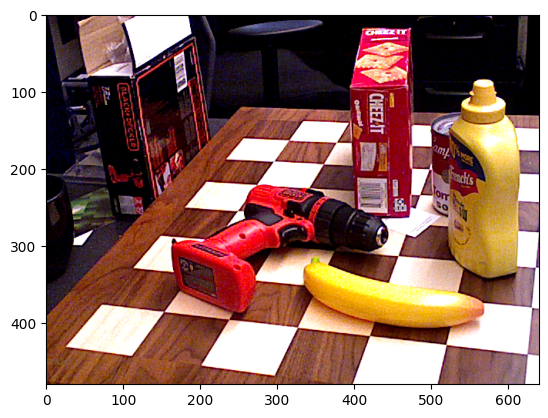

In [10]:
image_paths = get_image_list(osp.join(PROJ_ROOT,"datasets/BOP_DATASETS/ycbv/test/" + img_set + "/rgb"))#, osp.join(PROJ_ROOT,"datasets/BOP_DATASETS/ycbv/test/000057/depth"))

img_dir = osp.join(PROJ_ROOT,"datasets/BOP_DATASETS/ycbv/test/" + img_set + "/rgb/" + img_num + ".png")

img = cv2.imread(img_dir)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))


In [11]:
from det.yolox.utils import get_model_info, fuse_model, postprocess, vis
def vis_yolo(output, rgb_image, class_names, cls_conf=0.35):
    # rgb_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2RGB)
    if output is None:
        return rgb_image
    output = output.cpu()

    bboxes = output[:, 0:4]

    cls = output[:, 6]
    scores = output[:, 4] * output[:, 5]

    vis_res = vis(rgb_image, bboxes, scores, cls, cls_conf, class_names)
    return vis_res

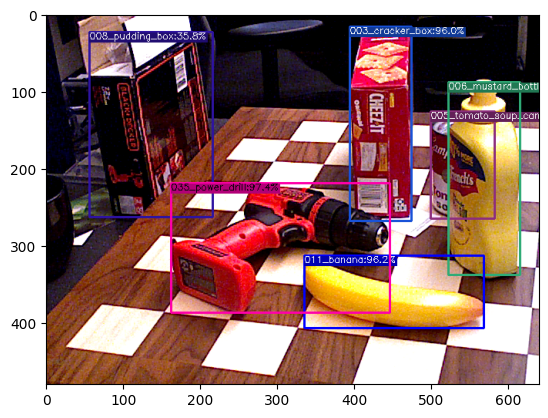

/home/meuli/gdrnpp_wkspc/gdrnpp_bop2022/core/gdrn_modeling/demo/predictor_yolo.py:137: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  detections = torch.tensor(detections[detections[:, 6].argsort()])
{'im_H': tensor([480., 480., 480., 480., 480., 480., 480., 480., 480., 480., 480., 480.,
        480., 480., 480., 480.], device='cuda:0'), 'im_W': tensor([640., 640., 640., 640., 640., 640., 640., 640., 640., 640., 640., 640.,
        640., 640., 640., 640.], device='cuda:0'), 'roi_img': tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0549, 0.0471, 0.0000,  ..., 0.7608, 0.7725, 0.7098],
          [0.0275, 0.0000, 0.0000,  ..., 0.3451, 0.2667, 0.1922],
          [0.2

In [12]:
output = yolo_predictor.inference(img)
out = vis_yolo(output[0], img, classes, cls_conf=0.35)
plt.imshow(cv2.cvtColor(out, cv2.COLOR_BGR2RGB))

In [13]:
data_dict = gdrn_predictor.preprocessing(outputs=output, image=img)

In [14]:
print(data_dict)

In [15]:
out_dict = gdrn_predictor.inference(data_dict)

In [16]:
poses = gdrn_predictor.postprocessing(data_dict, out_dict)

In [16]:
print(poses)

In [17]:
gdrn_imgs = gdrn_predictor.gdrn_visualization(batch=data_dict, out_dict=out_dict, image=img)

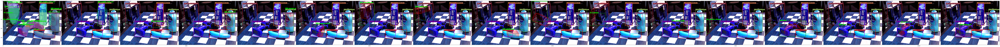

In [18]:
plt.figure(figsize=(200,20))
plt.imshow(gdrn_imgs)

In [17]:
print("\nhi")

In [42]:
all_output = []
for rgb_img, depth_img in image_paths:
    rgb_img = cv2.imread(rgb_img)
    if depth_img is not None:
        depth_img = cv2.imread(depth_img, 0)

        
    outputs = yolo_predictor.inference(image=rgb_img)

    data_dict = gdrn_predictor.preprocessing(outputs=outputs, image=rgb_img, depth_img=depth_img)
    out_dict = gdrn_predictor.inference(data_dict)
    poses = gdrn_predictor.postprocessing(data_dict, out_dict)
    gdrn_predictor.gdrn_visualization(batch=data_dict, out_dict=out_dict, image=rgb_img)


    out = vis_yolo(outputs[0], rgb_img, classes, cls_conf=0.35)
    all_output.append(out)

KeyboardInterrupt: 

In [41]:
print(poses)

20231020_130934|DBG|matplotlib.pyplot@339: Loaded backend module://matplotlib_inline.backend_inline version unknown.
20231020_130934|DBG|matplotlib.pyplot@339: Loaded backend module://matplotlib_inline.backend_inline version unknown.
20231020_130934|DBG|matplotlib.font_manager@1379: findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
20231020_130934|DBG|matplotlib.font_manager@1391: findfont: score(FontEntry(fname='/home/meuli/gdrnpp_wkspc/.venv/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf', name='DejaVu Sans', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 0.05
20231020_130934|DBG|matplotlib.font_manager@1391: findfont: score(FontEntry(fname='/home/meuli/gdrnpp_wkspc/.venv/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/cmr10.ttf', name='cmr10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
20231020_130934|DBG|matplotlib.

19
[[ 0.93853134  0.34500371 -0.01146178  0.07118013]
 [ 0.10058777 -0.30509532 -0.94699469 -0.03714886]
 [-0.33021361  0.88763128 -0.32104468  0.84066554]
 [ 0.          0.          0.          1.        ]]
[ 0.93853134  0.34500371 -0.01146178  0.07118013]
Okay... [ 0.93853134  0.34500371 -0.01146178  0.07118013]


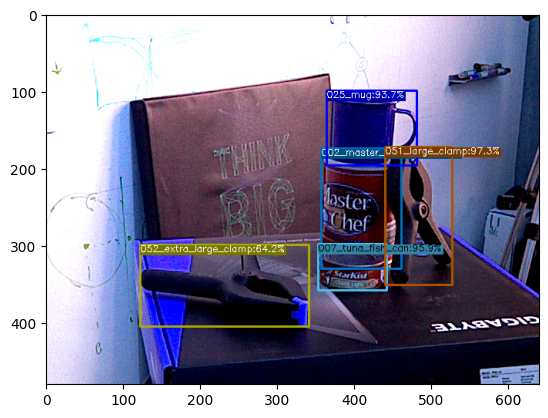

In [15]:
plt.imshow(all_output[20])